In [1]:
import numpy as np
import pandas as pd
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"
import warnings

warnings.filterwarnings("ignore")
# warnings.filterwarnings(action='once')

import matplotlib.image as mpimg
import matplotlib.pyplot as plt

%matplotlib inline
# plots
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import tensorflow as tf
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    f1_score,
    plot_confusion_matrix,
    precision_recall_curve,
    precision_score,
    recall_score,
    roc_auc_score,
    roc_curve,
)
from tensorflow import keras
from tensorflow.keras.applications.resnet import ResNet50
from tensorflow.keras.layers import (
    AveragePooling2D,
    AvgPool2D,
    Conv2D,
    Dense,
    Flatten,
    GlobalAveragePooling2D,
    MaxPooling2D,
)
from tensorflow.keras.models import Sequential

# keras
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tqdm import notebook, tqdm

In [2]:
PATH = "/app/_data/"
BATCH_SIZE = 64
SEED = 42

In [3]:
labels = pd.read_csv(PATH + "train.csv")

In [4]:
labels.head()
labels.info()

,image,labels
0,800113bb65efe69e.jpg,healthy
1,8002cb321f8bfcdf.jpg,scab frog_eye_leaf_spot complex
2,80070f7fb5e2ccaa.jpg,scab
3,80077517781fb94f.jpg,scab
4,800cbf0ff87721f8.jpg,complex


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18632 entries, 0 to 18631
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   18632 non-null  object
 1   labels  18632 non-null  object
dtypes: object(2)
memory usage: 291.2+ KB


In [5]:
labels["labels"].value_counts(normalize=True)

scab                               0.259017
healthy                            0.248175
frog_eye_leaf_spot                 0.170728
cider_apple_rust                   0.099828
complex                            0.085981
powdery_mildew                     0.063547
scab frog_eye_leaf_spot            0.036818
scab frog_eye_leaf_spot complex    0.010734
frog_eye_leaf_spot complex         0.008856
rust frog_eye_leaf_spot            0.006441
rust complex                       0.005206
powdery_mildew complex             0.004669
Name: labels, dtype: float64

In [6]:
len(labels.labels.unique())

12

In [7]:
labels["labels"] = labels["labels"].astype('category')

In [8]:
labels["num_cat"] = labels["labels"].cat.codes

In [9]:
labels

,image,labels,num_cat
0,800113bb65efe69e.jpg,healthy,4
1,8002cb321f8bfcdf.jpg,scab frog_eye_leaf_spot complex,11
2,80070f7fb5e2ccaa.jpg,scab,9
3,80077517781fb94f.jpg,scab,9
4,800cbf0ff87721f8.jpg,complex,1
...,...,...,...
18627,fffb900a92289a33.jpg,healthy,4
18628,fffc488fa4c0e80c.jpg,scab,9
18629,fffc94e092a59086.jpg,cider_apple_rust,0
18630,fffe105cf6808292.jpg,scab frog_eye_leaf_spot,10


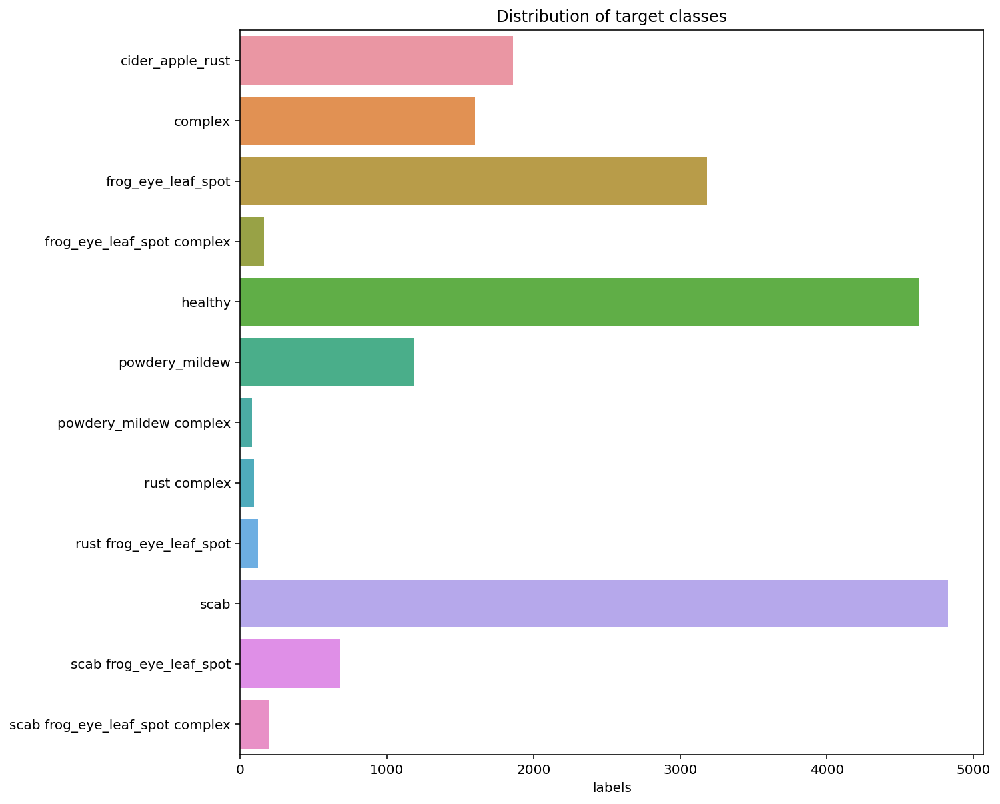

In [10]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of target classes")
sns.barplot(
    y=labels["labels"].value_counts().index,
    x=labels["labels"].value_counts(),
    orient="h",
)
plt.show();

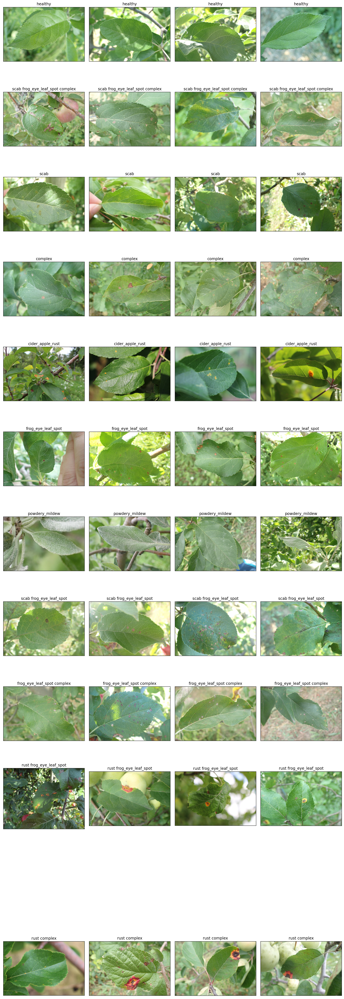

In [8]:
plt.figure(figsize=(15, 45))
for i, disease in enumerate(labels["labels"].unique()):
    data = labels.query("labels == @disease").sample(4)
    for j, image_name in enumerate(data["image"]):
        image = mpimg.imread("/app/_data/train_images/" + image_name)
        plt.subplot(12, 4, i * 4 + j + 1)
        plt.title(disease)
        plt.imshow(image)
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout()
plt.show();

In [15]:
def show_image(disease, num_image=4):
    plt.figure(figsize=(15, 3 * np.ceil(num_image/4)))
    data = labels.query("labels == @disease").sample(num_image)
    for j, image_name in enumerate(data["image"]):
        image = mpimg.imread("/app/_data/train_images/" + image_name)
        plt.subplot(np.ceil(num_image/4), 4, j + 1)
        plt.title(disease)
        plt.imshow(image,aspect='auto')
        plt.xticks([])
        plt.yticks([])
#     plt.tight_layout()
    plt.show();

In [16]:
# show_image('scab', 8)

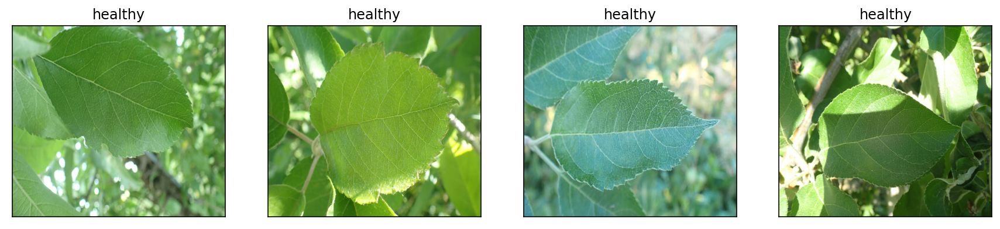

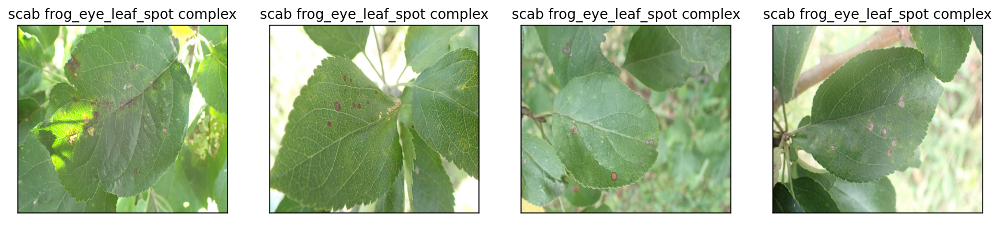

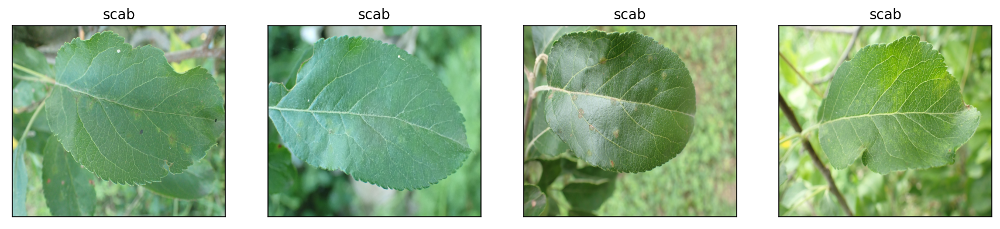

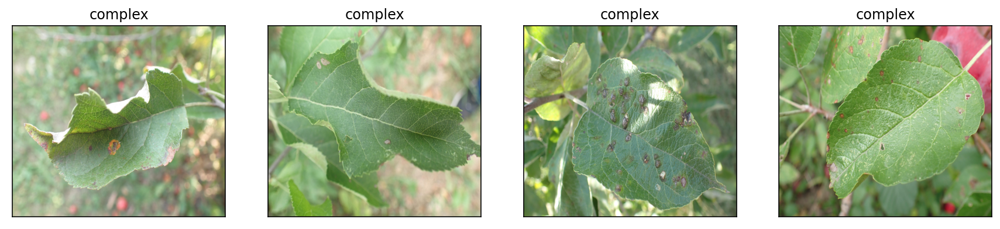

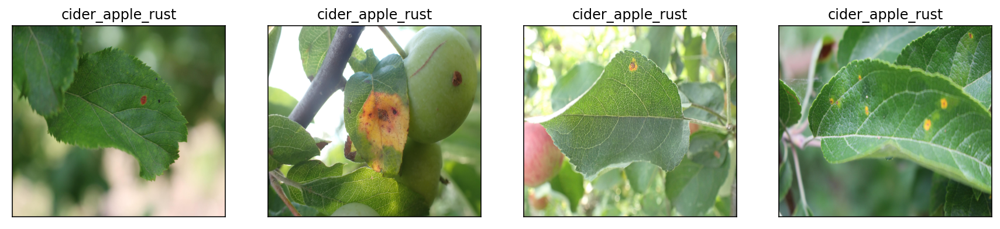

...

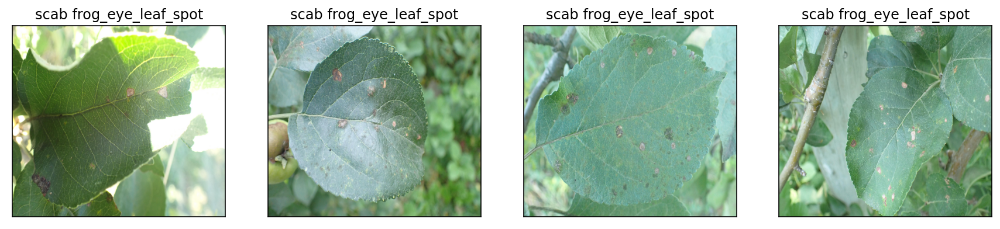

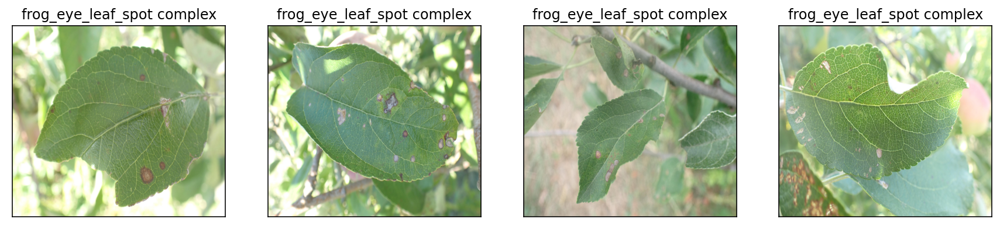

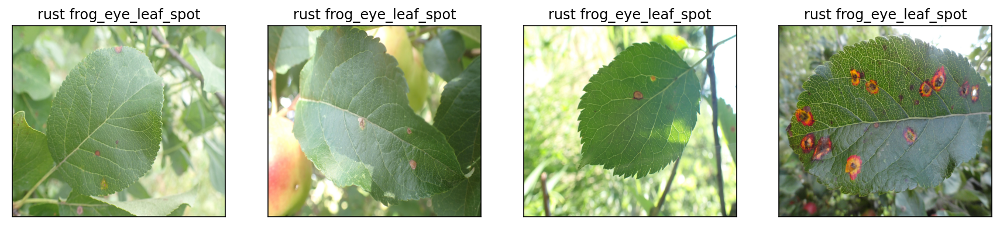

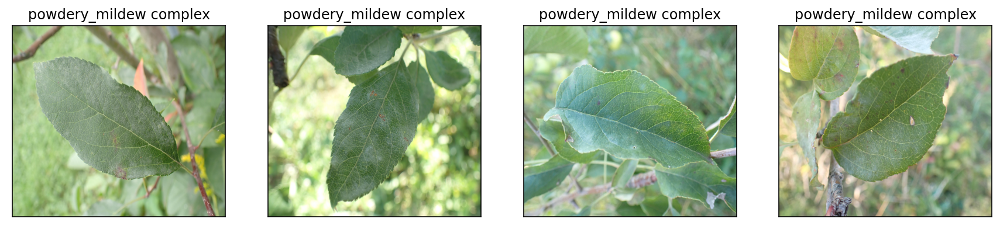

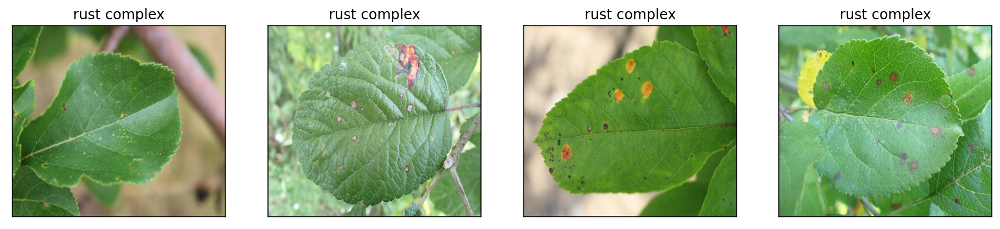

In [17]:
for disease in labels["labels"].unique():
    show_image(disease, 4)

In [11]:
train_datagen = ImageDataGenerator(rescale=1.0 / 255, validation_split=0.25)
train = train_datagen.flow_from_dataframe(
    dataframe=labels,
    directory=PATH + "train_images/",
    x_col="image",
    y_col="labels",
    target_size=(224, 224),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    subset="training",
    seed=SEED,
)

Found 13974 validated image filenames belonging to 12 classes.


In [12]:
valid_datagen = ImageDataGenerator(rescale=1.0 / 255, validation_split=0.25)
valid = valid_datagen.flow_from_dataframe(
    dataframe=labels,
    directory=PATH + "train_images/",
    x_col="image",
    y_col="labels",
    target_size=(224, 224),
    batch_size=BATCH_SIZE,
    class_mode="categorical",
    subset="validation",
    seed=SEED,
)

Found 4658 validated image filenames belonging to 12 classes.


In [13]:
# features, target = next(train)
# plt.figure(figsize=(10, 10))
# for i in range(1, 17):
#     image = features[i - 1]
#     label = target[i - 1]
#     plt.subplot(4, 4, i)
#     plt.imshow(image)
#     plt.xlabel(label)
#     plt.xticks([])
#     plt.yticks([])
#     plt.tight_layout()
# plt.show();

In [14]:
# def f1(y_true, y_pred):
#     precision = keras.metrics.Precision(y_true, y_pred)
#     recall = keras.metrics.Recall(y_true, y_pred)
#     return 2 * ((precision * recall) / (precision + recall))

In [15]:
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:2', device_type='GPU')]

In [16]:
backbone = ResNet50(input_shape=(224, 224, 3), weights="imagenet", include_top=False)
model_raw = Sequential()
model_raw.add(backbone)
model_raw.add(GlobalAveragePooling2D())
model_raw.add(Dense(units=12, activation="softmax"))
model_raw.compile(
    loss="CategoricalCrossentropy",
    optimizer=Adam(lr=0.001),
    metrics=["acc", keras.metrics.Recall(), keras.metrics.Precision()],
)

94773248/94765736 [==============================] - 7s 0us/step


In [17]:
history_raw = model_raw.fit( 
    train,
    validation_data=valid,
    epochs=20,
    batch_size=BATCH_SIZE,
    #     steps_per_epoch=64,
    #     validation_steps=16,
    verbose=1,
    use_multiprocessing=True,

)

Epoch 1/20
219/219 [==============================] - 2058s 9s/step - loss: 0.8071 - acc: 0.7560 - recall: 0.6851 - precision: 0.8325 - val_loss: 16.4541 - val_acc: 0.0820 - val_recall: 0.0820 - val_precision: 0.0820
Epoch 2/20
219/219 [==============================] - 2004s 9s/step - loss: 0.4832 - acc: 0.8481 - recall: 0.8064 - precision: 0.8910 - val_loss: 21.4037 - val_acc: 0.0820 - val_recall: 0.0820 - val_precision: 0.0820
Epoch 3/20
219/219 [==============================] - 1915s 9s/step - loss: 0.3880 - acc: 0.8759 - recall: 0.8408 - precision: 0.9113 - val_loss: 4.0001 - val_acc: 0.1213 - val_recall: 0.0316 - val_precision: 0.3134
Epoch 4/20
219/219 [==============================] - 1914s 9s/step - loss: 0.3361 - acc: 0.8866 - recall: 0.8597 - precision: 0.9208 - val_loss: 1.8704 - val_acc: 0.5193 - val_recall: 0.4790 - val_precision: 0.5650
Epoch 5/20
219/219 [==============================] - 1911s 9s/step - loss: 0.2608 - acc: 0.9121 - recall: 0.8906 - precision: 0.9356 

In [39]:
pd.DataFrame(history_raw.history).to_csv('history_raw.csv')

In [24]:
def f1(recall, precision):
    return 2 * ((precision * recall) / (precision + recall))

In [36]:
f1_score_train = f1(np.array(history_raw.history['recall']), np.array(history_raw.history['precision']))
f1_score_valid = f1(np.array(history_raw.history['val_recall']), np.array(history_raw.history['val_precision']))
f1_score_train
f1_score_valid

array([0.75161935, 0.84662484, 0.87464644, 0.88919318, 0.91252382,
       0.92562042, 0.95148794, 0.96436935, 0.96479988, 0.97133002,
       0.97398917, 0.9820059 , 0.98146354, 0.98398136, 0.98355014,
       0.98592557, 0.9869637 , 0.9795655 , 0.98785947, 0.98811314])

array([0.08200945, 0.08200945, 0.05734348, 0.51841524, 0.73117318,
       0.39773705, 0.67493743, 0.54354694, 0.66592079, 0.46429407,
       0.23985154, 0.47651007, 0.77035742, 0.58122905, 0.70372791,
       0.64464847, 0.79423557, 0.76246014, 0.73135988, 0.65040106])

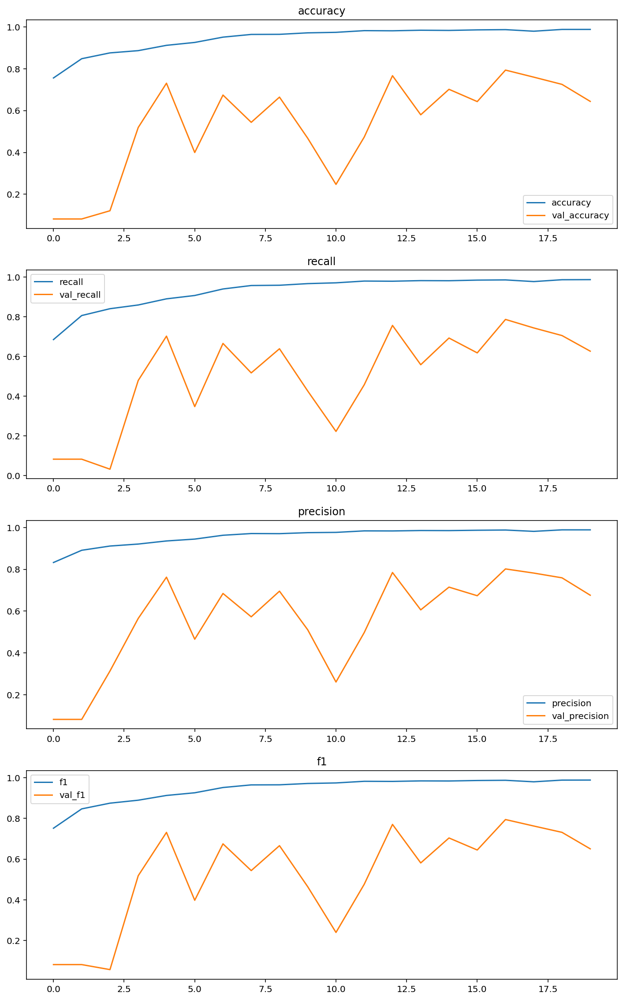

In [37]:
plt.figure(figsize=(12,20))
plt.subplot(4, 1, 1)
plt.title('accuracy')
plt.plot(history_raw.history['acc'], label='accuracy')
plt.plot(history_raw.history['val_acc'], label='val_accuracy')
plt.legend()

plt.subplot(4, 1, 2)
plt.title('recall')
plt.plot(history_raw.history['recall'], label='recall')
plt.plot(history_raw.history['val_recall'], label='val_recall')
plt.legend()

plt.subplot(4, 1, 3)
plt.title('precision')
plt.plot(history_raw.history['precision'], label = 'precision')
plt.plot(history_raw.history['val_precision'], label = 'val_precision')
plt.legend()

plt.subplot(4, 1, 4)
plt.title('f1')
plt.plot(f1_score_train, label = 'f1')
plt.plot(f1_score_valid, label = 'val_f1')
plt.legend()
plt.show();

In [41]:
model_raw.save('/app/models/model_raw')

INFO:tensorflow:Assets written to: /app/models/model_raw/assets
